In [1]:
import os
import re
import pandas as pd
import jieba.posseg as psg
from flashtext import KeywordProcessor

In [2]:
!pip install flashtext

In [3]:
!pip install jieba

## Pattern模块

In [437]:
# 导入词性转换表
dicdf = pd.read_csv('词性转换表v2.csv')
dicdf

,阴性词,阳性词,Unnamed: 2,Unnamed: 3
0,她,他,NaN,NaN
1,女,男,NaN,NaN
2,女士,先生,NaN,NaN
3,妻子,丈夫,NaN,NaN
4,夫人,先生,NaN,NaN
5,老婆,老公,NaN,NaN
6,雌,雄,NaN,NaN
7,母,父,或可替换公,NaN
8,姐妹,兄弟,NaN,NaN
9,姐,哥,NaN,NaN


In [6]:
# 根据词性转换表，制定转换词典
# dic1是男转女，dic2是女转男
# 分开的原因：按这个算法，可能会将同一个词转两次回到原来的词
standic1={}
standic2={}
for i in range(dicdf.shape[0]):
    key1=dicdf['阴性词'][i]
    key2=dicdf['阳性词'][i]
    if standic1.get(key1)==None:
        standic1[key1]=[key2]
    else:
        ls=standic1[key1]
        ls.append(key2)
        standic1[key1]=ls
    if standic2.get(key2)==None:
        standic2[key2]=[key1]
    else:
        ls=standic2[key2]
        ls.append(key1)
        standic2[key2]=ls
standic1,standic2

NameError: name 'dicdf' is not defined

In [4]:
standic1={'她': ['他'],
  '女': ['男'],
  '女士': ['先生'],
  '妻子': ['丈夫'],
  '老婆': ['老公'],
  '雌': ['雄'],
  '母': ['父'],
  '姐妹': ['兄弟'],
  '姐': ['哥'],
  '妹': ['弟'],
  '姑娘': ['小伙'],
  '姑': ['叔', '伯'],
  '阿姨': ['叔叔'],
  '姥': ['爷'],
  '妈妈': ['爸爸'],
  '娘': ['爹'],
  '奶奶': ['爷爷'],
  '外婆': ['外公'],
  '阿婆': ['阿伯'],
  '母父': ['父母'],
  '妈爸': ['爸妈']}

In [5]:
standic2={'他': ['她'],
  '男': ['女'],
  '先生': ['女士', '夫人'],
  '丈夫': ['妻子'],
  '老公': ['老婆'],
  '雄': ['雌'],
  '父': ['母'],
  '兄弟': ['姐妹'],
  '哥': ['姐'],
  '弟': ['妹'],
  '小伙': ['姑娘'],
  '叔': ['姑'],
  '叔叔': ['阿姨'],
  '爷': ['姥'],
  '爸爸': ['妈妈'],
  '爹': ['娘'],
  '爷爷': ['奶奶'],
  '外公': ['外婆'],
  '阿伯': ['阿婆']}

In [6]:
# 根据转换词典，制定基于pattern的转换器
kp1 = KeywordProcessor()
kp2 = KeywordProcessor()
kp1.add_keywords_from_dict(standic1)
kp2.add_keywords_from_dict(standic2)

In [7]:
kp2.get_all_keywords()#女转男 #查看和手动调整

{'她': '他',
 '女': '男',
 '女士': '先生',
 '夫人': '先生',
 '妻子': '丈夫',
 '老婆': '老公',
 '雌': '雄',
 '母': '父',
 '姐妹': '兄弟',
 '姐': '哥',
 '妹': '弟',
 '姑娘': '小伙',
 '姑': '叔',
 '阿姨': '叔叔',
 '阿婆': '阿伯',
 '姥': '爷',
 '妈妈': '爸爸',
 '娘': '爹',
 '奶奶': '爷爷',
 '外婆': '外公'}

In [8]:
kp1.get_all_keywords()#男转女

{'他': '她',
 '男': '女',
 '先生': '女士',
 '丈夫': '妻子',
 '老公': '老婆',
 '雄': '雌',
 '父': '母',
 '父母': '母父',
 '兄弟': '姐妹',
 '哥': '姐',
 '弟': '妹',
 '小伙': '姑娘',
 '叔': '姑',
 '叔叔': '阿姨',
 '伯': '姑',
 '爷': '姥',
 '爷爷': '奶奶',
 '爸爸': '妈妈',
 '爸妈': '妈爸',
 '爹': '娘',
 '外公': '外婆',
 '阿伯': '阿婆'}

## pos tagging模块

In [9]:
# 导入文本
data=[]
#theme=[]

root_path='answer/'
file_ls=os.listdir(root_path)
for file_path in file_ls:
    txt_ls=os.listdir(root_path+file_path)
    for txt_path in txt_ls:
        path=root_path+file_path+'/'+txt_path
        with open(path,encoding='gb18030',errors='ignore') as f:
            data.append(f.read())
            #theme.append(file_path)
data

['航空工程与维修\nAVIATION ENGINEERING & MAINTENANCE\n1999年\u3000第4期\u3000No.4\u30001999\n\n\n\n\u3000\u3000运用计算机辅助技术研制新机是缩短与国外航空制造技术差距的一条有效途径。本文介绍西安飞机工业公司运用计算机辅助工装技术制造B737－700垂尾部件的应用实例。\n应用计算机辅助技术制造波音737－700垂尾\nApplication of Computer Aided Manufacturing Technique in \nSubcontracting B737－700 Vertical Tail\n黄侠\n\u3000\u3000当今世界市场竞争日趋激烈，不断提高技术水平和质量控制能力是企业常胜不衰的法宝。1995年，西安飞机工业公司（西飞公司）在完成B737－300垂尾的基础上，又签订了制造B737－700垂尾合同，该项目的技术含量、工艺水平、制造难度远远高于B737－300垂尾。为此，西飞公司果断引进新的管理机制、新的控制技术和设备，从设计到制造全面采用计算机辅助应用技术，加强工装研制过程各个环节的质量控制，从而使西飞公司航空工艺制造水平与90年代国际先进企业接轨，上了一个新台阶。\n\u3000\u3000本文以B737－700垂尾工装研制为例，介绍西飞公司应用CAD/CAM/CAMS/CAI(计算机辅助设计/制造/测量/检测)系统和AQS(Advanced Quality System)中的HVC(先进质量体系中的零件偏差控制)系统技术，完成转包生产中装配工装的研制过程。\n工装研制模式的转换\n\u3000\u3000西飞公司从80年代开始接受国外转包生产合同，工装研制一直保留传统的“串行工程”模式，即各部门按顺序完成各自的专业工作，以模拟量作为各个工艺环节的协调依据。波音公司进行B737－700研制时，启动了新的研制模式棗“并行工程”，即各部门并行作业，以数字量传递作为各工艺环节的协调依据，为提高产品质量、缩短研制周期提供了新的途径。并行工程是对产品及其相关过程(包括制造过程和支持过程)进行并行、一体化设计的一种系统化的工作模式，对产品研制全面应用计算机辅助控制技术，完全摆脱了传统的模拟量传递工作方法。工装部门从工程部得到的技术依据是产品数据集，工装设计

In [11]:
data[0]

'航空工程与维修\nAVIATION ENGINEERING & MAINTENANCE\n1999年\u3000第4期\u3000No.4\u30001999\n\n\n\n\u3000\u3000运用计算机辅助技术研制新机是缩短与国外航空制造技术差距的一条有效途径。本文介绍西安飞机工业公司运用计算机辅助工装技术制造B737－700垂尾部件的应用实例。\n应用计算机辅助技术制造波音737－700垂尾\nApplication of Computer Aided Manufacturing Technique in \nSubcontracting B737－700 Vertical Tail\n黄侠\n\u3000\u3000当今世界市场竞争日趋激烈，不断提高技术水平和质量控制能力是企业常胜不衰的法宝。1995年，西安飞机工业公司（西飞公司）在完成B737－300垂尾的基础上，又签订了制造B737－700垂尾合同，该项目的技术含量、工艺水平、制造难度远远高于B737－300垂尾。为此，西飞公司果断引进新的管理机制、新的控制技术和设备，从设计到制造全面采用计算机辅助应用技术，加强工装研制过程各个环节的质量控制，从而使西飞公司航空工艺制造水平与90年代国际先进企业接轨，上了一个新台阶。\n\u3000\u3000本文以B737－700垂尾工装研制为例，介绍西飞公司应用CAD/CAM/CAMS/CAI(计算机辅助设计/制造/测量/检测)系统和AQS(Advanced Quality System)中的HVC(先进质量体系中的零件偏差控制)系统技术，完成转包生产中装配工装的研制过程。\n工装研制模式的转换\n\u3000\u3000西飞公司从80年代开始接受国外转包生产合同，工装研制一直保留传统的“串行工程”模式，即各部门按顺序完成各自的专业工作，以模拟量作为各个工艺环节的协调依据。波音公司进行B737－700研制时，启动了新的研制模式棗“并行工程”，即各部门并行作业，以数字量传递作为各工艺环节的协调依据，为提高产品质量、缩短研制周期提供了新的途径。并行工程是对产品及其相关过程(包括制造过程和支持过程)进行并行、一体化设计的一种系统化的工作模式，对产品研制全面应用计算机辅助控制技术，完全摆脱了传统的模拟量传递工作方法。工装部门从工程部得到的技术依据是产品数据集，工装设计部

In [12]:
# 文本清洗辅助代码
def replace_space(text):
    """清除连续空白"""
    text = re.sub(r'\n', '', text.strip())
    text = re.sub(r'\s*\n\s*', '', text)
    text = re.sub(r'\n\s*\n', '', text)
    text = re.sub(r'[^\S\n]', '', text)
    text = re.sub('(?<![\u4e00-\u9fa5]) (?=[\u4e00-\u9fa5])|(?<=[\u4e00-\u9fa5]) (?![\u4e00-\u9fa5])', '', text)
    return text

symbol=[',','，','!','?','。','！','？','......']

def exact_clean(s):
    if '【' in s or '】'in s:
        return False
    elif not(s and s.strip()):
        return False
    elif s in symbol:
        return False
    else:
        if (len(s)<3) or (len(s)>150):#
            return False
        else:
            lengths.append(len(s))
            return True
#             if len(s)<5:
#                 return False
#             else:
#                 nlengths.append(len(s))
#                 return True

In [16]:
# 文本清洗
segs=[]
lengths=[]
#nlengths=[]
for txt in data:
    txt=replace_space(txt)
    #txt=re.split(r'(\.|\!|\?|。|！|？|\.{6}|】)',txt)
    txt=re.split(r'(\,|\!|\?|。|，|！|？|\.{6}|】)',txt)
    print(txt)
    txt=list(filter(exact_clean,txt))
    for sts in txt:
        seg=psg.cut(sts)#一个seg是一句话
        segs.append(seg)
#segs

['航空工程与维修AVIATIONENGINEERING&MAINTENANCE1999年第4期No.41999运用计算机辅助技术研制新机是缩短与国外航空制造技术差距的一条有效途径', '。', '本文介绍西安飞机工业公司运用计算机辅助工装技术制造B737－700垂尾部件的应用实例', '。', '应用计算机辅助技术制造波音737－700垂尾ApplicationofComputerAidedManufacturingTechniqueinSubcontractingB737－700VerticalTail黄侠当今世界市场竞争日趋激烈', '，', '不断提高技术水平和质量控制能力是企业常胜不衰的法宝', '。', '1995年', '，', '西安飞机工业公司（西飞公司）在完成B737－300垂尾的基础上', '，', '又签订了制造B737－700垂尾合同', '，', '该项目的技术含量、工艺水平、制造难度远远高于B737－300垂尾', '。', '为此', '，', '西飞公司果断引进新的管理机制、新的控制技术和设备', '，', '从设计到制造全面采用计算机辅助应用技术', '，', '加强工装研制过程各个环节的质量控制', '，', '从而使西飞公司航空工艺制造水平与90年代国际先进企业接轨', '，', '上了一个新台阶', '。', '本文以B737－700垂尾工装研制为例', '，', '介绍西飞公司应用CAD/CAM/CAMS/CAI(计算机辅助设计/制造/测量/检测)系统和AQS(AdvancedQualitySystem)中的HVC(先进质量体系中的零件偏差控制)系统技术', '，', '完成转包生产中装配工装的研制过程', '。', '工装研制模式的转换西飞公司从80年代开始接受国外转包生产合同', '，', '工装研制一直保留传统的“串行工程”模式', '，', '即各部门按顺序完成各自的专业工作', '，', '以模拟量作为各个工艺环节的协调依据', '。', '波音公司进行B737－700研制时', '，', '启动了新的研制模式棗“并行工程”', '，', '即各部门并行作业', '，', '以数字量传递作为各工艺环节的协调依据', '，', '为提高产品质量、缩短研制周期提供了新的途径', '。', '并行工程是对产品及其相关过

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['计算机工程COMPUTERENGINEERING1999年第25卷第8期Vol.25No.81999数据采掘支持的新型DSS系统在intranet上的扩展徐海蔚', '，', '杨明福摘要：提出了一种采用数据采掘技术的决策支持系统', '。', '在指出数据采掘对决策支持系统应用的重要意义之后', '，', '阐明了一种根据用户需求及新技术的发展而提出的基于Browser/Server结构的DSS体系结构', '。', '采用这一体系结构', '，', '用户可以较方便地实现能自我更新的、功能强大而界面友好的、适应最广大用户需求的决策支持系统', '。', '关键词：决策支持系统；数据采掘；Intranet；WebDecisionSupportSystemwithDataMiningandItsExpandingonIntranetXuHaiwei', ',', 'YangMingfu(DepartmentofComputerScienceandEngineering', ',', 'EastChinaUniversityofScienceaTechnology', ',', 'Shanghai200237)【Abstract', '】', 'ThisarticleintroducesanewkindofDecisionSupporySystemwithDataMiningsupported.Afterdiscussingtheimportanceofmorepowerfulandself-renewableDSSwhichcouldfitthedemandsmoreproperly.【Keywords', '】', 'DSS;DataMining;Intranet;Web由于数据采掘本身就是一种从事实或观察数据的集合中寻找模式的决策支持过程', '，', '因此数据采掘和决策支持系统(DSS)是密不可分的', '。', '可以说', '，', '数据采掘的目的', '，', '就是为目标决策提供支持；而以数据采掘作为支持技术的新型决策支持系统', '，', '则能更加强大和具有实用价值', '。', '然而', ',', '传统的决策支持系统往往无法为广大企业经营人员充分利用', '，', '更无法体现数据采掘技术的优越', '。', '改造DSS系统的体系

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['【文献号', '】', '3-513【原文出处', '】', '《岭南文史》【原刊地名', '】', '广州【原刊期号', '】', '200101【原刊页号', '】', '9～12【分类号', '】', 'J5【分类名', '】', '舞台艺术【复印期号', '】', '200105【标题', '】', '从艺术和审美规律谈粤剧的若干问题【作者', '】', '吴世枫【正文', '】', '从70年代后期至80年代初', '，', '刚从“文化大革命”的文化专制下解放出来的粤剧', '，', '曾经红火了好几年', '。', '接踵而来的却是城市观众一年年锐减', '，', '以致许多粤剧团相继跌进了“多演多亏', '，', '少演少亏', '，', '不演不亏”的窘迫境地', '，', '甚至一些大剧院、名剧团也难以幸免', '。', '曾经鼎盛辉煌过的粤剧', '，', '骤然面临如此景况', '，', '始料不及的行内人', '，', '不禁惊呼陷入“萧条”、“低谷”、“危机”', '，', '并为此焦虑不已', '。', '有人更认为粤剧己成为“昨日黄花”和“夕阳艺术”', '，', '断言它的前途岌岌可危', '。', '于是', '，', '抢救、改革、振兴粤剧的问题被突出地提出来了', '。', '抢录保存传统剧目', '，', '尝试各种艺术改革', '，', '设立振兴基金', '，', '正视寻找市场', '，', '以至于开出道道单方……毫无疑问', '，', '这些努力都是有益的', '，', '但时至今日', '，', '尤其在城市里', '，', '并未出现如人们理想的那种大转变、大改观', '。', '在这种情况下', '，', '认真地多方面地作一点深层的冷思考', '，', '就显得尤其必要了', '。', '本文拟专门从艺术和审美规律上探讨一下有关粤剧的若干问题', '，', '作为一孔之见供人们参考研究', '。', '一、粤剧是民族戏曲艺术的精华之一', '，', '历史证明一种成熟的艺术是不会轻易失灭的粤剧目前碰到的困难', '，', '很容易使人产生困惑', '，', '以致自轻自贱', '，', '忘却了艺术规律的作用', '。', '曾经有一种颇为流行的观点——把传统戏曲、诗词甚至“五四”以来的小说和30-4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['环境科学研究RESEARCHOFENVIRONMENTALSCIENCES2001Vol.14No.1P.1-3', ',', '8西部大开发中的生态安全问题李康摘要：正确处理区域发展与生态安全是西部开发战略的关键', '。', '以可持续发展为目标的区域空间结构理论', '，', '分析了在新一轮科技革命和产业革命的新形势下推动区域发展和区域空间结构演变的决定性因素', '，', '以及实行效益原则与社会公平原则相统一的必要性', '，', '从中引出西部大开发中确保生态安全的极端重要性', '。', '并就实现区域发展与生态安全的双赢目标所必须建立的能力体系和制度体系提出了建议', '。', '关键词：西部大开发；生态安全；区域发展；区域空间理论分类号：X171.4文献标识码：A文章编号：1001-6929(2001)01-0001-03TheEcologicalSafetyinGreatWesternRegionDevelopmentinChinaLIKang（ChineseResearchAcdemyofEnvironmentalSciences', ',', 'Beijing100012', ',', 'China）Abstract：ToproperlydealwiththerelationshipbetweenregionaldevelopmentandecologicalsafetyisthekeyissueinthestrategyofthecurrentGreatWesternRegionDevelopment.Withtheobjectiveofsustainabledevelopmentandbyusingtheregionalspatialstructuretheories', ',', 'thecriticalfactorsforpromotingregionaldevelopmentandregionalspatialevolutionunderthecircumstancesofnewscientificrevolutionandindustryrevolutionwereanalyzed.Thenecessitytouniformlycarryoutthebenefitprincipleandsocialequityprinci

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['【文献号', '】', '1-815【原文出处', '】', '中国经济导报【原刊地名', '】', '京【原刊期号', '】', '19991215【原刊页号', '】', '⑥【分类号', '】', 'F14【分类名', '】', '特区经济与港澳台经济【复印期号', '】', '200001【标题', '】', '在深化合作中再造优势——关于澳门经济发展路向与策略的若干思考（中）【作者', '】', '蔡亦萌【正文', '】', '随着内地对外开放的不断扩大和深入', '，', '过往依靠港澳地区作为贸易和投资的惟一渠道或主要渠道的情况已经发生变化', '。', '目前', '，', '澳门与广东省、珠海等地的经济差距已经接近或消失', '，', '因此港澳之间以及港澳与内地之间的合作形式和优势互补格局都需要进一步提升和挖掘', '。', '澳门与内地经贸合作的发展潜力大澳门与内地的经贸合作虽在深度与广度上远不及内地与香港之间的关系', '，', '但仍有其独特并且是不小的发展潜力', '。', '东南亚金融风潮爆发后', '，', '亚洲地区大多数国家的经济纷纷陷入不景气', '，', '出现大幅调整', '。', '形成鲜明对比的是', '，', '人民币币值依然稳定', '，', '中国内地经济仍然保持着较为理想的增长态势', '。', '在这一背景下', '，', '加强两地经贸合作', '，', '以内地市场为依托', '，', '培育澳门新的发展机遇和新的经济动力显得尤为重要', '。', '过去', '，', '由于历史和政治等多种原因', '，', '澳门与内地的合作缺少沟通', '，', '缺乏高层推动', '，', '在一定程度上造成了重复建设', '，', '出现了资源浪费', '。', '最典型的例子是澳门和珠海各建大型机场', '，', '各自筹划建设大型港口、跨海（连接香港）大桥等等', '，', '造成不必要的消极后果', '。', '另外', '，', '经过十多年的发展', '，', '珠江三角洲地区的总体经济实力和经营成本已明显上升', '，', '原来以澳门资本与内地廉价土地、劳动力结合所形成的资源互补式垂直分工潜力已经不大', '。', '广东省已明确提出产业发展方向是由劳动密集型向技术密集型转轨', '，', '在

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['【文献号', '】', '1-1482【原文出处', '】', '求实【原刊地名', '】', '南昌【原刊期号', '】', '199907【原刊页号', '】', '39～41【分类号', '】', 'D1【分类名', '】', '社会主义研究【复印期号', '】', '199909【标题', '】', '试论知识经济时代中的社会主义低潮与重振【作者', '】', '张龙平【作者简介', '】', '作者单位南京政治学院研究生8队【正文', '】', '“资本主义必然灭亡、社会主义必然胜利”', '，', '这是革命导师在150年前就揭示和论证的科学论断', '，', '然而', '，', '现实的情况是', '，', '资本主义制度在世界上已有三四百年的历史', '，', '但至今未见任何一个发达资本主义国家因危机而进入灭亡的迹象', '，', '相反的是', '，', '随着社会主义“领头羊”苏联的解体', '，', '东欧剧变', '，', '社会主义阵营不断缩小', '，', '社会主义运动在20世纪末无可否认地走入低潮', '，', '原因何在', '？', '出路何在', '？', '本文试从经济形态演变及社会结构变迁中的科技因素这一角度对此略作探讨', '。', '一、科技因素是科学社会主义理论的基本内核之一首先', '，', '作为科学社会主义理论基石的历史唯物主义是以科学技术为基本内核的', '。', '唯物主义认为', '，', '人类社会发展的最终动力是生产力的发展', '，', '“物质生产力状况是所有的一切思想和各种趋向的根源”', '。', '无论作为意识形态的科学社会主义理论或是作为经济基础与上层建筑的社会主义经济政治制度都根源于取决于社会生产力的发展状况', '。', '然而', '，', '在人类生产力的生成过程中', '，', '“科学技术是最高意义的革命力量”', '，', '因为科学是知识形态的生产力', '，', '科学技术是人类生产力发展中最持久、最有力的杠杆', '。', '在近代发展史上', '，', '电力、机器等科技发明极大地武装了人类的劳动能力', '，', '并通过高潮不断的产业革命使得人类生产力呈加速度的方式迅猛发展', '。', '因此', '，', '科学技术是影响生产力与生产关系相互作用的核心

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['【文献号', '】', '2-1101【原文出处', '】', '文史哲【原刊地名', '】', '济南【原刊期号', '】', '199903【原刊页号', '】', '117～122【分类号', '】', 'F7【分类名', '】', '经济史【复印期号', '】', '199905【标题', '】', '１９９８年中国近代经济史研究述评【作者', '】', '郑起东【正文', '】', '1998年发表的中国近代经济史的学术论文共有291篇（注：本文所统计论文采自1998年1月至1998年12月发行的中央和地方各报刊和各大专院校的学报', '。', '）', '。', '从数量上看', '，', '较1997年有所增加（注：据拙著：《1997年中国近代经济史研究述评》', '，', '《1997年历史年鉴》', '。', '1997年发表的中国近代经济史的论文为253篇', '，', '研究北洋政府和国民政府时期的经济史论文为79篇', '。', '）', '，', '从质量上看', '，', '也较1997年有显著提高', '。', '低水平重复的现象仍然存在', '，', '但研究新问题的论文明显增多', '。', '其研究分布', '，', '从历史时期看有后移趋势', '，', '对于北洋政府和国民政府时期的研究有所增强', '，', '论文数目达107篇', '，', '较上年增加35％（注：据拙著：《1997年中国近代经济史研究述评》', '，', '《1997年历史年鉴》', '。', '1997年发表的中国近代经济史的论文为253篇', '，', '研究北洋政府和国民政府时期的经济史论文为79篇', '。', '）', '。', '从研究主题看', '，', '农业经济史成为重点', '，', '有关论文达54篇', '，', '占全部论文的19％', '。', '1998年的中国近代经济史研究主要体现出以下特点：一、方法论受到重视1996年', '，', '吴承明出版了有关经济史研究方法的论文集《市场·近代化·经济史论》', '，', '引起了经济史学界对方法论的重视', '。', '1998年陈支平发表了《中国社会经济史学理论的重新思考》（注：《中国社会经济史研究》1998年第1期', '。', '）一文', '，', '指出：“‘封

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['【文献号', '】', '1-994【原文出处', '】', '方法【原刊地名', '】', '京【原刊期号', '】', '199901【原刊页号', '】', '34～35【分类号', '】', 'D0【分类名', '】', '政治学【复印期号', '】', '199903【标题', '】', '全球化时代的政治管理模式【作者', '】', '俞可平【正文', '】', '自从有了国家及其政府以后', '，', '善政便成为人们所期望的理想政治管理模式', '，', '这一点古今中外概莫例外', '。', '我国古已称之的“善政”', '，', '大体相当于英语里所说的“goodgovernment”（可直译为“良好的政府”或“良好的统治”）', '。', '在中国传统政治文化中', '，', '善政的最主要意义', '，', '就是能给官员带来清明和威严的公道和廉洁', '，', '各级官吏像父母一样热爱和对待自己的子民', '，', '没有私心', '，', '没有偏爱', '。', '不过', '，', '更抽象地说', '，', '善政的内容', '，', '无论在中国还是在外国', '，', '在古代还在现代', '，', '都基本类似', '，', '一般都包括以下几个要素：严明的法度、清廉的官员、很高的行政效率、良好的行政服务', '。', '毫无疑问', '，', '只要政府存在一天', '，', '这样的善政将始终是公民对于政府的期望和理想', '。', '但是', '，', '善政在政治理想中的这种长期独占鳌头的地位', '，', '从90年代以后却在世界各国日益遭到了严重的挑战', '。', '与善政构成挑战的是“善治”', '，', '其英文名为goodgovernance（可直译为“良好的治理”等）', '。', '世界银行1992年年度报告的标题就是“治理与发展”（GovernanceandDevelopment）', '，', '《国际社会科学杂志》1998年第3期还出了一个名为“治理”（Governance）的专号', '。', '“治理”（governance）与“统治”（government）从词面上看似乎差别并不大', '，', '但其实际含义却有很大的不同', '。', '治理一词的基本含义是指在一个既定的范围内运用

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['中国体育科技CHINASPORTSCIENCEANDTECHNOLOGY1999年第3期1986～1996年间世界田径竞技水平发展态势的探讨曹景伟曹莉孙晋海摘要：本文对1986～1996年10年间世界田径运动竞技水平发展变化进行了探讨', '。', '揭示了世界田径男、女各项竞技水平发展变化的总态势', '，', '对其发展和衰退的程度进行了排序', '。', '旨在弄清世界田径各项的发展趋势', '，', '为我国田径运动项目的合理布局和制定运动训练计划提供参考', '。', '关键词：世界∥田径∥竞技水平∥发展∥变化AnAnalysisofDevelopmentofWorldTrackandFieldCompetitionfrom1986to1996CaoJingwei', ',', 'CaoLi', ',', "SunJinhaiAbstract:Thetenyears'(1986～1996)developmentofworldtrackandfieldisanalyzedinthispapertorevealtheoverallvariationofcompetitivelevelsineachmen'sandwomen'sevent.Basedonthisanalysis", ',', 'alltheseeventsarerankedaccordingtotheirprogressionandrecession.Thiswillprovideareferencetolearnthedevelopmentofworldtrackandfield', ',', 'optimallydeveloptrackandfieldeventinthecountryandworkouttrainingplan.Keywords:world∥trackandfield∥competitivelevel1前言80年代后', '，', '田径各项竞技水平的发展变化如何', '?', '多年来', '，', '对这类问题的研究较多地停留在定性的描述上', '，', '缺乏量化方面有效而总体的研究', '。', '为此', '，', '本文以1986～1996年间世界男、女前10名运动员的运动成绩为基础', '，', '运用灰色系统理论与方法', '，', '具体探讨了10年

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['【文献号', '】', '1-1188【原文出处', '】', '北京师范大学学报：社科版【原刊期号', '】', '199605【原刊页号', '】', '46-51【分类号', '】', 'K5【分类名', '】', '世界史【作者', '】', '刘家和【复印期号', '】', '199612【标题', '】', '历史的比较研究与世界历史［＊］【正文', '】', '摘要比较研究的基本功能在于辩同异', '，', '从异中见同', '，', '从同中见异', '。', '世界历史于诸多国别史基础上发展而成', '，', '或者说是由扬弃诸“小一”（国别史）而成的“大一”（世界史）', '。', '不过这个“大一”并非抽象的明一', '，', '而是由诸“小一”有机地构成的一', '。', '因此', '，', '世界历史研究的关键之点就在于明一、多之关系', '。', '比较研究的辨同异正是世界历史研究中的明一、多的不可或缺的条件', '。', '历史的比较研究', '，', '不论在国外还是国内', '，', '现在都是一个比较热门的研究取向', '。', '世界历史（WorldHistory）或者全球史（GlobalHistory）', '，', '现在也是一个日益为人们重视的研究领域', '。', '其实', '，', '比较研究作为一种方法', '，', '几乎和历史学一样的古老；而世界历史的写作', '，', '也在很早的时期就是历史学家的一种高尚的理想了', '。', '希罗多德（Herodotus）所写的《历史》虽然以希腊波斯战争为主题', '，', '但是它也涉及了当时他所知世界的历史', '。', '司马迁所写的《史记》虽然以当时的中国通史为基本', '，', '但是也涉及了当时他所知的世界；而且', '，', '以后的中国历代的“正史”', '，', '大多数都继承了《史记》的作法', '。', '当然', '，', '这些都不是世界史', '，', '而只是一种史家注意周围世界的倾向；真正叙述全世界历史的书的出现', '，', '在时代上则要晚得多', '。', '因为在世界范围的联系出现以前', '，', '要求写真正的世界史', '，', '那实际是不可能的', '。', '而且', '，', '如果按严格的要求来说', '，

In [14]:
segs[0]

<generator object cut at 0x000002897F2A3C78>

biggest sentence has 150 words


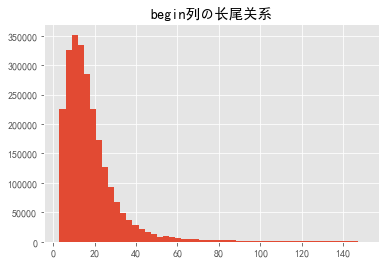

In [25]:
# 未去掉太长句时的句子长度分布

largest_sen = max(lengths)
print('biggest sentence has {} words'.format(largest_sen))
    
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['font.sans-serif']=['SimHei'] #用来正常显示中文标签
plt.style.use("ggplot")
plt.hist([i for i in lengths], bins=50)
plt.title("begin列の长尾关系")
plt.show()

In [10]:
#没删除数据：
len(lengths)

2459472

In [30]:
a=np.array(lengths)
np.save('lengths.npy',a)   # 保存为.npy格式

D:\Software\anaconda\lib\site-packages\ipykernel_launcher.py:47: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "width" which is no longer supported as of 3.3 and will become an error two minor releases later
D:\Software\anaconda\lib\site-packages\ipykernel_launcher.py:47: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "height" which is no longer supported as of 3.3 and will become an error two minor releases later


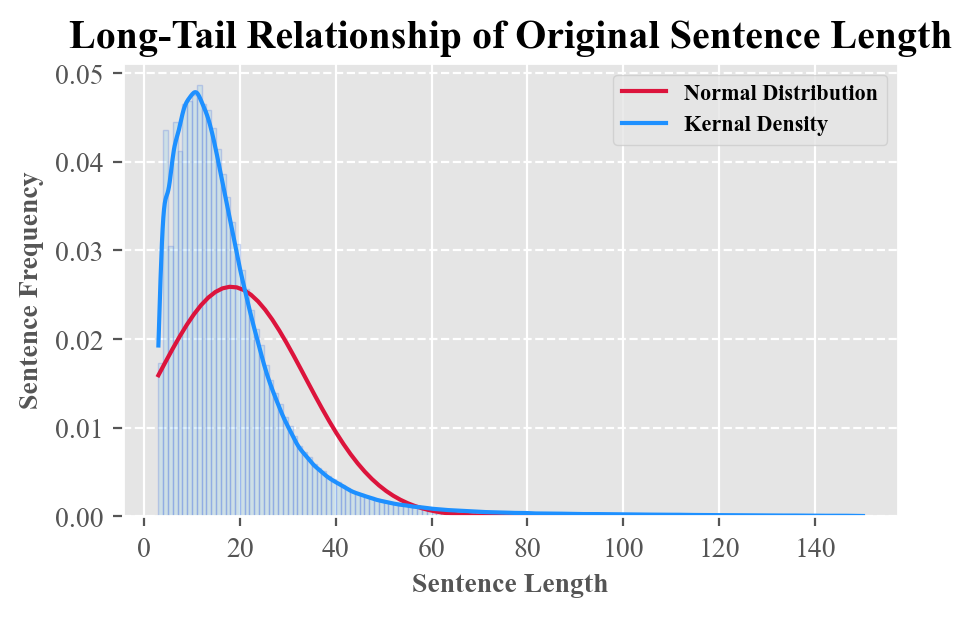

In [29]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import pyplot as plt
from matplotlib.font_manager import FontProperties
import matplotlib.mlab as mlab
from scipy.stats import norm
import math
#from scipy.sparse.linalg import _norm as norm
from pylab import *
%matplotlib inline
plt.rcParams['font.family'] = "Times New Roman"
font = FontProperties(family='Times New Roman', size=10, weight='bold')
#plt.rcParams['font.sans-serif']=['SimHei'] #用来正常显示中文标签
#plt.style.use("ggplot")
plt.subplots(figsize=(5, 3), dpi=200,facecolor='w')
plt.hist([i for i in lengths],density=1,histtype = "bar", facecolor='skyblue', 
         ec='royalblue',bins=np.arange(min(lengths),max(lengths),1), alpha=0.25)#
plt.title("Long-Tail Relationship of Original Sentence Length",weight="bold")#slateblue
plt.xlabel("Sentence Length", fontproperties=font, size=10)
plt.ylabel("Sentence Frequency", fontproperties=font, size=10)
legend_font = { 'family': 'Times New Roman',  # 字体
        'size': 10,  # 字号
        'weight': "bold",  # 加粗
              }
plt.grid(axis="y", linestyle='--', zorder=0)
#plt.tick_params(top="off",right='off')

x1=np.linspace(min(lengths),max(lengths),100)
#normal=norm.pdf(x1,sum(s)/len(s),np.std(s,ddof=1))
#normal=mlab.normpdf(x1, sum(s)/len(s), np.std(s,ddof=1))
def pdf(x,u,sig):
    y = np.exp(-(x - u) ** 2 / (2 * sig ** 2)) / (math.sqrt(2 * math.pi) * sig)
    return y

normal = pdf(x1, sum(lengths)/len(lengths), np.std(lengths,ddof=1))
#print(normal)

line1, = plt.plot(x1,normal,color='crimson',linewidth=1.5)
kde=mlab.GaussianKDE(lengths)
x2=np.linspace(min(lengths),max(lengths),1000)
line2, = plt.plot(x2,kde(x2),color='dodgerblue',linewidth=1.5)
plt.legend([line1,line2],['Normal Distribution','Kernal Density'],loc='best',
           prop={"family": "Times New Roman", "size": 8,"weight":"bold"}
           , frameon=True)
#plt.legend([line1],['Normal Distribution'],loc='best')

plt.savefig(r'C:\Users\Lenovo\Desktop\temp.png',width=5, height=4, dpi=900,bbox_inches='tight')
plt.show()

In [436]:
print(len(lengths))

2014165


In [13]:
lengths=[i for i in lengths if i<50]
len(lengths)

2138812

biggest sentence has 50 words


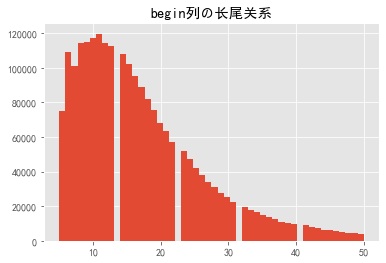

In [402]:
# 去掉太长句后的分布

largest_sen = max(nlengths)
print('biggest sentence has {} words'.format(largest_sen))
    
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['font.sans-serif']=['SimHei'] #用来正常显示中文标签
plt.style.use("ggplot")
plt.hist([i for i in nlengths], bins=50)
plt.title("begin列の长尾关系")
plt.show()

In [ ]:
# # 不做转换只要分词结果
# beforels=['']*len(segs)
# for i,seg in enumerate(segs):#对第i句话
#     beforewords=[ele.word for ele in seg]
#     beforestr=' '.join(beforewords)
#     beforels[i]=beforestr

## 对tagging的结果做转换

In [11]:
# 文本转换
count1,count2=0,0#看看转换了多少次
ifcount=[0]*len(segs)#按文章算，看看
newstrs=['']*len(segs)
beforels=['']*len(segs)
for i,seg in enumerate(segs):#对第i句话
    words=[[ele.word,ele.flag] for ele in seg]
    beforewords=[word[0]for word in words]
    beforestr=' '.join(beforewords)
    beforels[i]=beforestr
    for word in words:
        #if ('n' in word[1]) or ('r' in word[1]):
        temp=word[0]
        word[0]=kp1.replace_keywords(word[0])#男to女看是否转成功
        if word[0]!=temp:#如果转成，ok，走
            count1+=1
            ifcount[i]+=1
        else:#没转成，可能是中性或女to男
            word[0]=kp2.replace_keywords(word[0])
            if word[0]!=temp:#如果转成，ok，走
                count2+=1
                ifcount[i]+=1
    onlywords=[word[0]for word in words]
    newstr=' '.join(onlywords)
    newstrs[i]=newstr

Building prefix dict from the default dictionary ...
Dumping model to file cache C:\Users\ZHANGJ~1\AppData\Local\Temp\jieba.cache
Loading model cost 1.563 seconds.
Prefix dict has been built successfully.


In [12]:
# 男转女次数
count1

71533

In [13]:
# 女转男次数（啧啧啧，这数量差距）
count2

13852

In [14]:
df=pd.DataFrame({'before':beforels,'after':newstrs,'trans_count':ifcount})
df

,before,after,trans_count
0,本文 介绍 西安飞机工业公司 运用 计算机辅助 工装 技术 制造 B737 － 700 垂尾...,本文 介绍 西安飞机工业公司 运用 计算机辅助 工装 技术 制造 B737 － 700 垂尾...,0
1,不断 提高 技术水平 和 质量 控制能力 是 企业 常胜 不衰 的 法宝,不断 提高 技术水平 和 质量 控制能力 是 企业 常胜 不衰 的 法宝,0
2,1995 年,1995 年,0
3,西安飞机工业公司 （ 西飞公司 ） 在 完成 B737 － 300 垂尾 的 基础 上,西安飞机工业公司 （ 西飞公司 ） 在 完成 B737 － 300 垂尾 的 基础 上,0
4,又 签订 了 制造 B737 － 700 垂尾 合同,又 签订 了 制造 B737 － 700 垂尾 合同,0
...,...,...,...
2223102,一场 狂飙 也 才 总算 过去 了,一场 狂飙 也 才 总算 过去 了,0
2223103,"- - 没有 科学 的 "" 教育 ""","- - 没有 科学 的 "" 教育 """,0
2223104,只是 培养 信仰,只是 培养 信仰,0
2223105,而 不是 教育 . 没有 受过 科学 教育 的 人,而 不是 教育 . 没有 受过 科学 教育 的 人,0


In [15]:
df.to_csv('data_answer_4.csv')

## 例子

In [355]:
a=psg.cut('你不能要求一个女人永远是少女时代。她深深低下头去，沉默了半响，举起魔杖给了远处那个啸笑的男人一个阿瓦达。马尔福夫人在她丈夫的尸体身边哭泣。德拉科跪在那里，一声不响。')
count1,count2=0,0
words=[[ele.word,ele.flag] for ele in a]
for word in words:
    #if ('n' in word[1]) or ('r' in word[1]):
    temp=word[0]
    word[0]=kp1.replace_keywords(word[0])#男to女看是否转成功
    if word[0]!=temp:#如果转成，ok，走
        print(temp,'→',word[0])
        count1+=1
    else:#没转成，可能是中性或女to男
        word[0]=kp2.replace_keywords(word[0])
        if word[0]!=temp:#如果转成，ok，走
            print(temp,'→',word[0])
            count2+=1
#twords=[word[]]
' '.join([word[0]for word in words])

女人 → 男人
少女时代 → 少男时代
她 → 他
男人 → 女人
夫人 → 先生
她 → 他
丈夫 → 妻子


'你 不能 要求 一个 男人 永远 是 少男时代 。 他 深深 低下头去 ， 沉默 了 半响 ， 举起 魔杖 给 了 远处 那个 啸 笑 的 女人 一个 阿瓦 达 。 马尔福 先生 在 他 妻子 的 尸体 身边 哭泣 。 德拉科 跪 在 那里 ， 一声不响 。'